# Tanpa Matching

# Libraries

In [39]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import csv
from copy import deepcopy
import shapely.geometry as shapgeo

# General Function

## Read

In [2]:
def preprocess_name(imgpath, label):
    imgname = imgpath.split(".")[0]
    if label == "1":
        return imgname+"_p"
    else:
        return imgname+"_n"

def read_images(csvdir):
    with open(csvdir, newline="") as csvfile:
        imgs = dict()
        reader = csv.DictReader(csvfile)
        pcount = 0
        ncount = 0
        for row in reader:
            img_name = preprocess_name(row["ImagePath"].split("/")[-1], row["Labels"])
            bgr_img = cv2.imread(row["ImagePath"], cv2.IMREAD_UNCHANGED)
            imgs[img_name] = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
        
        return imgs

## Display

In [3]:
def display_all(imgs, subs=(84,4), fgsz=(5,170), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def display_all_with(imgs, cc, subs=(84,4), fgsz=(5,170), use_gray=True):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k][:,:,cc], cmap='gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def save_plots(imgs, suptitle, savedir, subs=(84,4), fgsz=(5,170), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
    fig.suptitle(suptitle)
    fig.savefig(savedir)
    print(f'Figure is successfully saved at {savedir}')
    
def display_all_histo(imgs, subs=(84,4), fgsz=(5,170)):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            # print(list(imgs.values())[k])
            sample_histo = cv2.calcHist([list(imgs.values())[k]],[0],None,[256],[0,256]) 
            axs[i, j].plot(sample_histo)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1

## Draw

In [4]:
def draw_od_line(imgs, roi_line, color):
    odlines = {}
    for img in imgs:
        odlines[img] = cv2.ellipse(imgs[img], 
                                   roi_line[img], 
                                   color, 
                                   3, 
                                   cv2.LINE_AA)
    return odlines

def draw_oc_line(imgs, roi_line, color):
    drawn_oc = {}
    
    for img in imgs:
        drawn_oc[img] = cv2.circle(imgs[img],roi_line[img][0],roi_line[img][1],color, 3)
    return drawn_oc

# Preprocess

## Histogram Matching

In [5]:
from skimage.exposure import match_histograms

In [6]:
def histogram_matching(images):
    matched = {}
    ref_img = r"/Users/teguhsatya/Pictures/trials/KAGGLE_RETINA/ORIGA/Images_Cropped/094.jpg"
    reference_bgr = cv2.imread(ref_img, cv2.IMREAD_UNCHANGED)
    reference = cv2.cvtColor(reference_bgr, cv2.COLOR_BGR2RGB)
    for image in images:
        matched[image] = match_histograms(images[image], reference, channel_axis=-1)
    
    return matched

## Gamma Correction

In [7]:
def adjust_gamma(image, gamma=1.0):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0,256)]).astype("uint8")
    return cv2.LUT(image, table)

## Remove Blood Vessel

In [8]:
def segment_vessel(imgs):
    vessel_segment = {} # for development purposes
    clahe_kernel = cv2.createCLAHE(2, (8,8))
    circular_SE = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25,25))
    
    for img in imgs:
        # use grayscale image
        grayscale = cv2.cvtColor(imgs[img], cv2.COLOR_RGB2GRAY)
        # img negative
        img_negative = cv2.bitwise_not(grayscale)
        tophat = cv2.morphologyEx(img_negative, cv2.MORPH_TOPHAT, kernel=circular_SE)
        ret, th1 = cv2.threshold(tophat, 3, 255, cv2.THRESH_BINARY)
        vessel_segment[img] = th1
    return vessel_segment

In [9]:
def remove_bvessel(imgs):
    segmented_vessel = segment_vessel(imgs)
    without_vessel = {}
    for (k1, v1), (k2, v2) in zip(imgs.items(), segmented_vessel.items()):
        print(f'Processing {k1}...')
        without_vessel[k1] = cv2.inpaint(imgs[k1], segmented_vessel[k2], 25, cv2.INPAINT_TELEA)
    return without_vessel

# Segmentation

## Segmentasi OC

In [10]:
from skimage.exposure import rescale_intensity
from skimage.segmentation import flood, flood_fill
from skimage.filters import sobel
from skimage.segmentation import clear_border

In [11]:
def set_bleeds(img, dist=100):
    '''
    A bleed is a small area around the edge of 
    your artwork that extends beyond the “finished” 
    cut edge of your document.
    '''
    img[:, :dist] = 0
    img[:dist, :] = 0
    img[-dist:, :] = 0
    img[:, -dist:] = 0
    
    return img

In [12]:
def get_circle(contours):
    conts = np.array([contour.shape[0] for contour in contours])
    cont_idx = np.argmax(conts)
    (x,y), radius = cv2.minEnclosingCircle(contours[cont_idx])
    return (x,y), radius

def select_boundaries(bnrs):
    cont, hcy = cv2.findContours(bnrs, 
                                     cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = get_circle(cont)
    center = (int(x),int(y))
    radius = int(radius)
    return (center, radius)

In [13]:
def get_oc(images):
    # screen = {}
    boundaries = {}
    binaries = {}
    
    for image in images:
        h, w = images[image].shape[:2]
        green = images[image][:,:,1]
        rescaled = rescale_intensity(green)
        corrected = adjust_gamma(rescaled, 0.2)
        ret, th1 = cv2.threshold(corrected, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        eroded = cv2.erode(th1, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15,15)))
        bleeds = set_bleeds(eroded)
        closed = cv2.morphologyEx(bleeds, cv2.MORPH_CLOSE, \
                                  kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (45,45)))
        center_rad = select_boundaries(closed)
        boundaries[image] = center_rad
        canvas = np.zeros_like(th1, dtype='uint8')
        binaries[image] = cv2.circle(canvas, center_rad[0], center_rad[1], (255, 255, 255), -1)
    
    print('done')
        
    return boundaries, binaries

## Segmentasi OD

In [14]:
from skimage.feature import canny
from skimage.filters import sobel
from skimage.exposure import is_low_contrast, rescale_intensity

In [15]:
def get_which_ellipse(contours):
    conts = np.array([contour.shape[0] for contour in contours])
    cont_idx = np.argmax(conts)
    ellipse = cv2.fitEllipse(contours[cont_idx])
    return ellipse

In [16]:
def stretch_contrast(image):
    stretch = 255 * (image - image.min()/ (image.max() - image.min()))
    return stretch.astype('uint8')

In [17]:
def extract_od(images):
    od_boundaries = {}
    od_binaries = {}
    p = {}
    for image in images:
        lab = cv2.cvtColor(images[image], cv2.COLOR_RGB2LAB)
        l_value = lab[:,:,0]
        l_rescaled = rescale_intensity(l_value)
        l_stretched = stretch_contrast(l_rescaled)
        l_inverted = cv2.bitwise_not(l_stretched)
        bleed = set_bleeds(l_inverted, 10)
        gmc = adjust_gamma(bleed, 0.8) # 0.8
        blurred = cv2.medianBlur(gmc, 45)
        ret, th = cv2.threshold(blurred, 80, 255, cv2.THRESH_TOZERO) # 85
        ret2, th2 = cv2.threshold(th, 80, 255, cv2.THRESH_BINARY)# 40
        conts, hier = cv2.findContours(th2, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        # OD Boundaries
        ellipse = get_which_ellipse(conts)
        od_boundaries[image] = ellipse
        # OD Binaries
        canvas = np.zeros_like(th, dtype='uint8')
        od_binaries[image] = cv2.ellipse(canvas, ellipse, (255,255,255), -1)
        
        # ret, th = cv2.threshold(gmc, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        # closed = cv2.morphologyEx(blur, cv2.MORPH_CLOSE, kernel=cv2.getStructuringElement(cv2.MORPH_RECT, (15,25)))
        
        
        
        # p[image] = th2
        
    # display_all(p, use_gray=True)
    return od_boundaries, od_binaries

# Fex

In [18]:
import re

In [19]:
def extract_features(ods, ocs):
    print('Extracting features...')
    features = []
    for od, oc in zip(ods, ocs):
        print(f'Images: {od}')
        identified_label = ''.join(re.findall('[a-zA-Z]+', od))
        if identified_label.lower() == 'n':
            label = 0
        else:
            label = 1
        cdr, vcdr, disc_width = get_cdr((ods[od], ocs[oc]))
        quadrant_width = nrr_quadrant(ods[od], ocs[oc])
        I, N, S, T = quadrant_width
        rdr = get_rdr(ods[od], ocs[oc], disc_width)
        features.append([od, cdr, vcdr, rdr, I, S, N, T, label])
    print('Done!')
        
        
    return features

## RDR

In [20]:
def get_rdr(od, oc, dw):
    nrr = cv2.subtract(od, oc)
    ret, th = cv2.threshold(nrr, 128, 255, cv2.THRESH_BINARY)
    conts, _ = cv2.findContours(th, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    RDR = 0
    # cek jika OD dan OC terdeteksi
    if len(conts) != 2:
        RDR = 0.2 # 0.19
        return RDR
    else:
        # ambil contours
        outer = [cv2.approxPolyDP(conts[0], 0.1, True)]
        inner = [cv2.approxPolyDP(conts[1], 0.1, True)]
        # visualisasi
        h, w = nrr.shape[:2]
        # Squeeze contours for further processing
        outer = np.vstack(outer).squeeze()
        inner = np.vstack(inner).squeeze()
        # Calculate centroid of inner contour
        M = cv2.moments(inner)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])

        # Calculate maximum needed radius for later line intersections
        r_max = np.min([cx, w - cx, cy, h - cy])

        # Set up angles (in degrees)
        angles = np.arange(0, 360, 4)

        # Initialize distances
        dists = np.zeros_like(angles)

        # Prepare calculating the intersections using Shapely
        poly_outer = shapgeo.asLineString(outer)
        poly_inner = shapgeo.asLineString(inner)
        
        for i, angle in enumerate(angles):
            # Convert angle from degrees to radians
            angle = angle / 180 * np.pi

            # Calculate end points of line from centroid in angle's direction
            x = np.cos(angle) * r_max + cx
            y = np.sin(angle) * r_max + cy
            points = [(cx, cy), (x, y)]

            # Calculate intersections using Shapely
            poly_line = shapgeo.LineString(points)
            insec_outer = np.array(poly_outer.intersection(poly_line))
            insec_inner = np.array(poly_inner.intersection(poly_line))

            # Calculate distance between intersections using L2 norm
            try:
                dists[i] = np.linalg.norm(insec_outer - insec_inner)
            except ValueError:
                continue

        # plt.imshow(vis)
        res = np.vstack([angles, dists]).T
        try:
            min_dist = min(dists[dists!=0])
        except ValueError:
            return 2
        else:
            return round(min_dist/dw, 4)
    return 0

## NRR Quadrants

In [21]:
def generate_masks(img_shapes):
    canvas = np.zeros(img_shapes, np.uint8)
    masks = [0,0,0,0]
    triangle_pts = np.array([
        [0, img_shapes[1]],
        [int(img_shapes[1]/2), int(img_shapes[0]/2)],
        [img_shapes[1], img_shapes[1]]
    ])
    masks[0] = cv2.fillPoly(canvas, [triangle_pts],(255, 255, 255))
    angle = 90
    for i in range(1, 4):
        rotation_m = cv2.getRotationMatrix2D((int(masks[0].shape[1]/2), int(masks[0].shape[1])/2), angle, 1.0)
        rotated = cv2.warpAffine(masks[0], rotation_m, (masks[0].shape[1], masks[0].shape[0]))
        masks[i] = rotated
        angle+=90
    return masks

In [22]:
def nrr_quadrant(od, oc):
    masks = generate_masks(od.shape) #  I, N, S, T
    neuroretinal = cv2.subtract(od, oc)
    quadrant_width = [0, 0, 0, 0]
    for i in range(len(masks)):
        masked = cv2.bitwise_and(neuroretinal, masks[i], masks[i])
        ret,binary = cv2.threshold(masked, 127, 255, cv2.THRESH_BINARY)
        contours,hierarchy = cv2.findContours(binary,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
        x,y,w,h = cv2.boundingRect(contours[0])
        if i%2 == 0:
            quadrant_width[i] = h
        else:
            quadrant_width[i] = w
    return quadrant_width

## CDR dan VCDR

In [23]:
def get_cdr(optics):
    optic_width = [] # order: disc width, cup width
    optic_height = [] # order: disc height, cup height
    for optic in optics:
        cnt, _ = cv2.findContours(optic, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
        x,y,w,h = cv2.boundingRect(cnt[0])
        optic_width.append(w)
        optic_height.append(h)
    # print(f'width: {optic_width}\nheight: {optic_height}')
    return round(optic_width[1]/optic_width[0], 4), round(optic_height[1]/optic_height[0], 4), optic_width[0]

# Main

## Read

In [24]:
IMAGES_CSV = r"/Users/teguhsatya/Desktop/helloNew/glokumarch/dataset/selected_dataset.csv"

In [25]:
images = read_images(IMAGES_CSV)

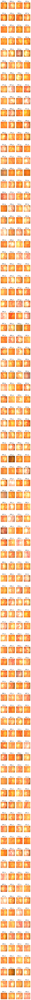

In [26]:
display_all(images)

## Histogram Matching

In [27]:
# matched = histogram_matching(images)

## Blood Vessel Removal

In [28]:
no_vessel = remove_bvessel(images)

Processing 638_p...
Processing 604_p...
Processing 348_p...
Processing 228_p...
Processing 572_p...
Processing 229_p...
Processing 598_p...
Processing 407_p...
Processing 349_p...
Processing 605_p...
Processing 613_p...
Processing 439_p...
Processing 377_p...
Processing 571_p...
Processing 558_p...
Processing 362_p...
Processing 389_p...
Processing 160_p...
Processing 612_p...
Processing 158_p...
Processing 366_p...
Processing 560_p...
Processing 549_p...
Processing 213_p...
Processing 429_p...
Processing 398_p...
Processing 159_p...
Processing 165_p...
Processing 171_p...
Processing 617_p...
Processing 601_p...
Processing 615_p...
Processing 359_p...
Processing 588_p...
Processing 589_p...
Processing 402_p...
Processing 628_p...
Processing 600_p...
Processing 465_p...
Processing 317_p...
Processing 511_p...
Processing 277_p...
Processing 505_p...
Processing 289_p...
Processing 458_p...
Processing 116_p...
Processing 300_p...
Processing 506_p...
Processing 512_p...
Processing 076_p...


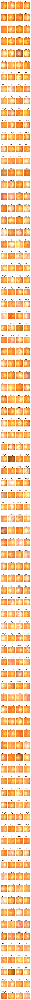

In [29]:
display_all(no_vessel)

## Segmentasi

### OC

In [30]:
oc_boundaries, oc_binaries = get_oc(no_vessel)

done


In [31]:
imgc = deepcopy(images)
drawn_oc = draw_oc_line(imgc, oc_boundaries, (0, 0, 255))

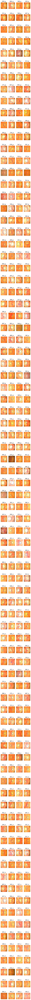

In [32]:
display_all(drawn_oc)

### OD

In [33]:
od_boundaries, od_binaries = extract_od(no_vessel)

In [34]:
docpy = deepcopy(drawn_oc)

In [35]:
full_drawn = draw_od_line(docpy, od_boundaries, (0, 255, 0))

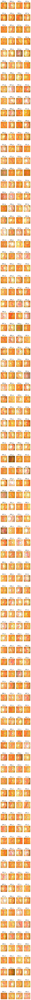

In [36]:
display_all(full_drawn)

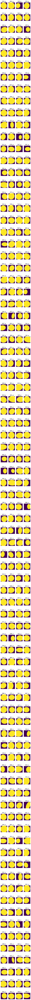

In [37]:
display_all(od_binaries)

## Features Extraction

In [41]:
features = extract_features(od_binaries, oc_binaries)

Extracting features...
Images: 638_p


/var/folders/zp/4lwldrsx6hqd2pm6w4s0wvg40000gn/T/ipykernel_24800/506838683.py:14: ShapelyDeprecationWarning: The proxy geometries (through the 'asShape()', 'asLineString()' or 'LineStringAdapter()' constructors) are deprecated and will be removed in Shapely 2.0. Use the 'shape()' function or the standard 'LineString()' constructor instead.
  rdr = get_rdr(ods[od], ocs[oc], disc_width)
/var/folders/zp/4lwldrsx6hqd2pm6w4s0wvg40000gn/T/ipykernel_24800/506838683.py:14: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  rdr = get_rdr(ods[od], ocs[oc], disc_width)


Images: 604_p
Images: 348_p
Images: 228_p
Images: 572_p
Images: 229_p
Images: 598_p
Images: 407_p
Images: 349_p
Images: 605_p
Images: 613_p
Images: 439_p
Images: 377_p
Images: 571_p
Images: 558_p
Images: 362_p
Images: 389_p
Images: 160_p
Images: 612_p
Images: 158_p
Images: 366_p
Images: 560_p
Images: 549_p
Images: 213_p
Images: 429_p
Images: 398_p
Images: 159_p
Images: 165_p
Images: 171_p
Images: 617_p
Images: 601_p
Images: 615_p
Images: 359_p
Images: 588_p
Images: 589_p
Images: 402_p
Images: 628_p
Images: 600_p
Images: 465_p
Images: 317_p
Images: 511_p
Images: 277_p
Images: 505_p
Images: 289_p
Images: 458_p
Images: 116_p
Images: 300_p


IndexError: tuple index out of range

In [ ]:
dataframe = pd.DataFrame(data=features, \
                         columns=['ImagesName', 'CDR', 'VCDR', 'RDR', 'I', 'S', 'N', 'T', 'Labels'])

In [ ]:
dataframe

In [ ]:
dataframe[dataframe['Labels'] == 0]

In [ ]:
dataframe[dataframe['Labels'] == 1]

In [ ]:
dataframe.to_csv('/Users/teguhsatya/Desktop/helloNew/glokumarch/exportedDataframe/withoutMatchedFeatures.csv', \
                 index=False, encoding='utf-8')